# Data Drift Explainability: Interpretable Shift Detection with NannyML

**Alerting Meaningful Multivariate Drift and ensuring Data Quality**

Model monitoring is becoming a hot trend in machine learning. With the crescent hype in the activities concerning the MLOps, we register the rise of tools and research about the topic.

One of the most interesting is for sure the **Confidence-based Performance Estimation (CBPE)** algorithm developed by NannyML. They implemented a novel procedure to **estimate future models' performance degradation in absence of ground truth.** It may yield great advantages in detecting performance drops since, in real applications, the labels could be expensive to collect and available in delay.

The CBPE algorithm is available in the NannyML package together with some **interesting shift detection strategies.** From the standard univariate drift detection methods to the more advanced multivariate feature drift approaches, we have at our disposal a great arsenal to **automatically detect silent model failures.**


In this post, we focus on the multivariate shift detection strategies. We want to investigate **how to detect a multivariate feature shift.** We make a comparison with the univariate case to demonstrate why the latter, in some cases, could not be enough to alert data drift. In the end, we make a step further, **introducing a hybrid approach to provide explainable multivariate drift detection.**

## Univariate vs Multivarate Drift

**Univariate drift** takes place when a variable registers a significant difference in distribution. Practically, we monitor each feature independently and check whether its distribution change over time. It could be carried out straightforwardly by comparing statistics between the new observations and past ones. For these reasons, univariate detection is easy to communicate and fully understandable.

**Multivariate drift** occurs when the relationships between input data change. Detecting multivariate changes could be more complicated to interpret, but often it is required to override the pitfalls of univariate detection.

The causes behind univariate and multivariate drift may vary according to use cases. Whatever the application, the results of univariate feature drift may be misleading. Let’s investigate why.

In [1]:
import itertools
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.linear_model import Ridge
from sklearn.model_selection import cross_val_predict, KFold

import nannyml as nml

/home/bruno/miniconda3/envs/bru_ds/lib/python3.8/site-packages/dask/dataframe/utils.py:367: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  _numeric_index_types = (pd.Int64Index, pd.Float64Index, pd.UInt64Index)
/home/bruno/miniconda3/envs/bru_ds/lib/python3.8/site-packages/dask/dataframe/utils.py:367: FutureWarning: pandas.Float64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  _numeric_index_types = (pd.Int64Index, pd.Float64Index, pd.UInt64Index)
/home/bruno/miniconda3/envs/bru_ds/lib/python3.8/site-packages/dask/dataframe/utils.py:367: FutureWarning: pandas.UInt64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  _numeric_index_types = (pd.Int64Index, pd.Float64Index, pd.UInt64Index)


In [2]:
### UTILITY FUNCTION FOR SINUSOIDAL GENERATION ###

def gen_sinusoidal(timesteps, amp, freq, noise):
    
    X = np.arange(timesteps)
    e = np.random.normal(0,noise, (timesteps,))
    y = amp*np.sin(X*(2*np.pi/freq))+e

    return y

In [3]:
### GENERATE TABULAR DATA ###

freq = 24*60
train_len = freq*10
test_len = freq*4

np.random.seed(0)
X1_train = gen_sinusoidal(train_len, 7, freq, 2)
X2_train = gen_sinusoidal(train_len, 10, freq, 2)
X1_test = gen_sinusoidal(test_len, 7, freq, 2)
X2_test = gen_sinusoidal(test_len+freq, 10, freq, 2)[freq//2:-freq//2]

X1 = np.r_[X1_train, X1_test]
X2 = np.r_[X2_train, X2_test]
X3 = np.random.normal(0,1, (train_len+test_len,))
X4 = np.random.normal(0,2, (train_len+test_len,))

features = ['X1','X2','X3','X4']
timestamps = pd.date_range('2022-01-01', periods=train_len+test_len, freq='MIN', name='timestamp') 
X = pd.DataFrame(
    {'X1':X1, 'X2':X2, 'X3':X3, 'X4':X4, 'timestamp':timestamps},
)
X['day'] = timestamps.day_of_year
X['y_pred_proba'] = np.random.uniform(0,1, (train_len+test_len,))
X['y_true'] = np.random.randint(0,2, (train_len+test_len,))

X['partition'] = 'reference'
X.loc[np.arange(train_len+test_len)>=(train_len-freq*2),'partition'] = 'analysis'

print(X.shape)
X.head()

(20160, 9)


,X1,X2,X3,X4,timestamp,day,y_pred_proba,y_true,partition
0,3.528105,0.022401,0.003158,-1.837228,2022-01-01 00:00:00,1,0.305601,1,reference
1,0.830858,-3.782663,-0.387581,-0.553841,2022-01-01 00:01:00,1,0.491560,0,reference
2,2.018562,-3.217855,0.403232,-3.541266,2022-01-01 00:02:00,1,0.358966,1,reference
3,4.573414,-1.841112,-0.018621,0.952791,2022-01-01 00:03:00,1,0.953258,0,reference
4,3.857283,-0.663319,-1.039750,3.070938,2022-01-01 00:04:00,1,0.728678,1,reference


## Limitations of Univariate Drift Detection

Supposing we have at our disposal four series of data (obtained through a simulation): two correlated sinusoids and two random noise features. We also consider two subsets (periods) of data to carry out our experiment. With the “reference” period we are referring to the historical data at our disposal. With the “analysis” period we are referring to the new samples we want to analyze.

In our “reference” period, the data follow the same patterns maintaining unchanged their relationship. In the “analysis” period we observe a variation in the verse of the relationship between the blue and the red sinusoids. More precisely, the two features are positively correlated in the “reference” period while they become negatively correlated by the end of the “analysis” period.

/home/bruno/miniconda3/envs/bru_ds/lib/python3.8/site-packages/pandas/plotting/_matplotlib/core.py:1114: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(


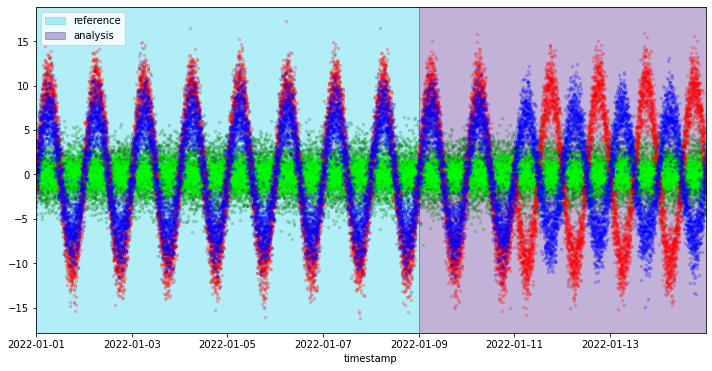

In [4]:
### PLOT GENERATED DATA ###

plt.figure(figsize=(12,6))
plt.axvspan(*list(X[X['partition'] == 'reference'].timestamp.agg(['min','max'])), alpha=0.3, color='#00c8e5', label='reference')
plt.axvspan(*list(X[X['partition'] == 'analysis'].timestamp.agg(['min','max'])), alpha=0.3, color='#3b0280', label='analysis')
X.plot.scatter(x='timestamp', y='X4', alpha=0.2, s=6, c='green', ax=plt.gca())
X.plot.scatter(x='timestamp', y='X3', alpha=0.2, s=6, c='lime', ax=plt.gca())
X.plot.scatter(x='timestamp', y='X2', alpha=0.2, s=6, c='red', ax=plt.gca())
X.plot.scatter(x='timestamp', y='X1', alpha=0.2, s=6, c='blue', ax=plt.gca())
plt.xlim((timestamps[0],timestamps[-1])); plt.legend(); plt.ylabel(None); plt.show()

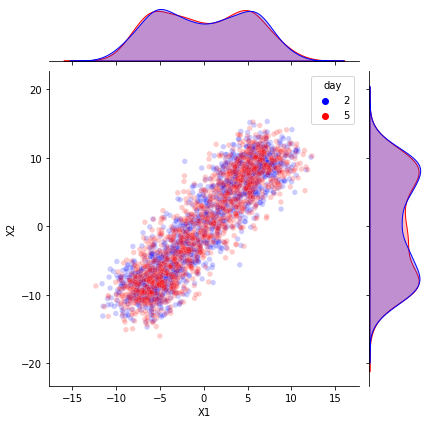

In [5]:
### POSITIVE CORRELATION BETWEEN X1 AND X2 ###

X_plot = pd.concat([X[X.day == 2], X[X.day == 5]], ignore_index=True)
sns.jointplot(data=X_plot, x='X1', y='X2', alpha=0.2, s=30, hue='day', palette='bwr')

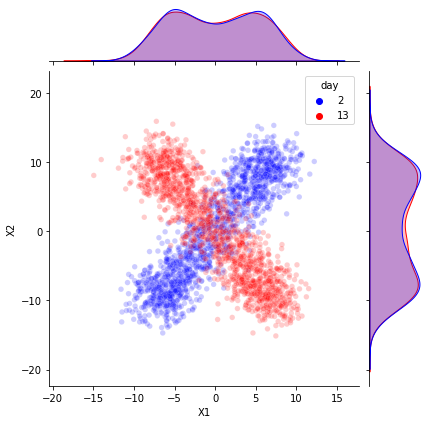

In [6]:
### NEGATIVE CORRELATION BETWEEN X1 AND X2 ###

X_plot = pd.concat([X[X.day == 2], X[X.day == 13]], ignore_index=True)
sns.jointplot(data=X_plot, x='X1', y='X2', alpha=0.2, s=30, hue='day', palette='bwr')

**The relationship is changed but the univariate distributions remain unchanged. Can our univariate drift detection be effective?**

In [10]:
X

,X1,X2,X3,X4,timestamp,day,y_pred_proba,y_true,partition
0,3.528105,0.022401,0.003158,-1.837228,2022-01-01 00:00:00,1,0.305601,1,reference
1,0.830858,-3.782663,-0.387581,-0.553841,2022-01-01 00:01:00,1,0.491560,0,reference
2,2.018562,-3.217855,0.403232,-3.541266,2022-01-01 00:02:00,1,0.358966,1,reference
3,4.573414,-1.841112,-0.018621,0.952791,2022-01-01 00:03:00,1,0.953258,0,reference
4,3.857283,-0.663319,-1.039750,3.070938,2022-01-01 00:04:00,1,0.728678,1,reference
...,...,...,...,...,...,...,...,...,...
20155,-2.336427,2.039119,0.237365,-2.036724,2022-01-14 23:55:00,14,0.488881,0,analysis
20156,-2.052099,0.371217,0.169067,-0.776876,2022-01-14 23:56:00,14,0.889626,0,analysis
20157,2.521180,-0.400845,0.580241,1.679102,2022-01-14 23:57:00,14,0.858390,0,analysis
20158,2.258951,0.738397,-0.561375,-0.421195,2022-01-14 23:58:00,14,0.528416,1,analysis


In [12]:
### COMPUTE UNIVARIATE DRIFT DETECTION ###

univariate_detector = nml.drift.univariate.calculator.UnivariateDriftCalculator(
    column_names=['X1','X2','X3','X4'],
    timestamp_column_name='timestamp'
).fit(X[X['partition'] == 'reference'])

univariate_results = univariate_detector.calculate(X)

In [16]:
### PLOT UNIVARIATE DRIFT DETECTION RESULTS ###

for feature in ['X1','X2','X3','X4']:
    figure = univariate_results.plot(
        kind='distribution'#,
        #feature_label=feature.label
    )
    figure.show()